***
*Project:* Audio Processing Neural Network

*Author:* Jingwei Liu, Computer Music Ph.D., UC San Diego
***

# <span style="background-color:darkorange; color:white; padding:2px 6px">DCT NN</span> 

# Discrete Cosine Transform Neural Network

Here we apply the time-frequency techniques in audio processing to design a specialized neural network for audio. To avoid the complexity of complex number operations, instead of Discrete Fourier Transform, we use its equivalent real-valued form -- Discrete Cosine Transform.

In [1]:
import torch
import numpy as np
import matplotlib.pyplot as plt
import librosa
from IPython.display import Audio
torch.cuda.is_available()

True

In [2]:
dev = torch.device("cuda") # operate on GPU "cuda" or CPU "cpu"

### Discrete Cosine Transform

- DCT-III

\begin{equation}
X_k = \frac{1}{2}x_0 + \sum_{n=1}^{N-1} x_n \cos \big[\frac{\pi}{N} (k + \frac{1}{2} ) \cdot n \big] \qquad \text{for } k = 0,\dots,N-1
\end{equation}

- DCT-II

\begin{equation}
X_k = \sum_{n=0}^{N-1} x_n \cos \big[\frac{\pi}{N} (n + \frac{1}{2} ) \cdot k \big] \qquad \text{for } k = 0,\dots,N-1
\end{equation}

In [63]:
N = 512
DCT_3 = torch.cos(torch.outer(torch.arange(N)+1/2,torch.arange(N))*torch.pi/N)
DCT_3[:,0] = 1/2
DCT_3

tensor([[ 0.5000,  1.0000,  1.0000,  ...,  0.0092,  0.0061,  0.0031],
        [ 0.5000,  1.0000,  0.9998,  ..., -0.0276, -0.0184, -0.0092],
        [ 0.5000,  0.9999,  0.9995,  ...,  0.0460,  0.0307,  0.0153],
        ...,
        [ 0.5000, -0.9999,  0.9995,  ..., -0.0460,  0.0308, -0.0154],
        [ 0.5000, -1.0000,  0.9998,  ...,  0.0277, -0.0184,  0.0093],
        [ 0.5000, -1.0000,  1.0000,  ..., -0.0093,  0.0061, -0.0031]])

In [64]:
DCT_2 = torch.cos(torch.outer(torch.arange(N),torch.arange(N)+1/2)*torch.pi/N)
DCT_2

tensor([[ 1.0000,  1.0000,  1.0000,  ...,  1.0000,  1.0000,  1.0000],
        [ 1.0000,  1.0000,  0.9999,  ..., -0.9999, -1.0000, -1.0000],
        [ 1.0000,  0.9998,  0.9995,  ...,  0.9995,  0.9998,  1.0000],
        ...,
        [ 0.0092, -0.0276,  0.0460,  ..., -0.0460,  0.0277, -0.0093],
        [ 0.0061, -0.0184,  0.0307,  ...,  0.0308, -0.0184,  0.0061],
        [ 0.0031, -0.0092,  0.0153,  ..., -0.0154,  0.0093, -0.0031]])

In [65]:
torch.matmul(DCT_2,DCT_3)

tensor([[ 2.5600e+02, -7.6294e-06,  4.5776e-05,  ..., -3.3188e-04,
          1.5259e-04,  1.3351e-05],
        [-3.8147e-06,  2.5600e+02,  7.6294e-06,  ...,  1.3304e-04,
         -5.5313e-05, -3.3379e-05],
        [ 2.2888e-05,  7.6294e-06,  2.5600e+02,  ..., -1.9073e-05,
          6.7711e-05, -1.0675e-04],
        ...,
        [-1.8953e-04,  1.3942e-04, -7.3548e-06,  ...,  2.5600e+02,
         -1.3809e-03,  1.7509e-03],
        [ 7.8961e-05, -8.3774e-05,  6.4894e-05,  ..., -1.3809e-03,
          2.5600e+02, -2.4109e-03],
        [-5.4240e-06, -2.1458e-05, -8.4562e-05,  ...,  1.7509e-03,
         -2.4109e-03,  2.5600e+02]])

In [67]:
(torch.matmul(DCT_2,DCT_3)/(N/2) - torch.eye(N)).sum()

tensor(1.4966e-05)

DCT-III and DCT-II are unnormalized inverse of each other.

- DCT Orthogonal

\begin{equation}
X_k = \frac{1}{\sqrt{N}} \Big(x_0 + \sqrt{2} \sum_{n=1}^{N-1} x_n \cos \big[\frac{\pi}{N} (k + \frac{1}{2} ) \cdot n \big] \Big) \qquad \text{for } k = 0,\dots,N-1
\end{equation}

In [56]:
N = 512
DCT_o = torch.cos(torch.outer(torch.arange(N)+1/2,torch.arange(N))*torch.pi/N)
DCT_o[:,0] = DCT_o[:,0]/np.sqrt(N)
DCT_o[:,1:] = DCT_o[:,1:]/np.sqrt(N) * np.sqrt(2)
DCT_o

tensor([[ 0.0442,  0.0625,  0.0625,  ...,  0.0006,  0.0004,  0.0002],
        [ 0.0442,  0.0625,  0.0625,  ..., -0.0017, -0.0012, -0.0006],
        [ 0.0442,  0.0625,  0.0625,  ...,  0.0029,  0.0019,  0.0010],
        ...,
        [ 0.0442, -0.0625,  0.0625,  ..., -0.0029,  0.0019, -0.0010],
        [ 0.0442, -0.0625,  0.0625,  ...,  0.0017, -0.0012,  0.0006],
        [ 0.0442, -0.0625,  0.0625,  ..., -0.0006,  0.0004, -0.0002]])

In [57]:
torch.matmul(DCT_o.t(),DCT_o)

tensor([[ 1.0000e+00, -8.9407e-08, -2.9802e-08,  ..., -9.8348e-07,
          5.0664e-07, -3.7253e-08],
        [-8.9407e-08,  1.0000e+00,  2.9802e-08,  ...,  5.1782e-07,
         -2.4587e-07, -1.2666e-07],
        [-2.9802e-08,  2.9802e-08,  1.0000e+00,  ..., -6.7055e-08,
          2.6077e-07, -4.4727e-07],
        ...,
        [-1.0440e-06,  5.4348e-07, -2.9748e-08,  ...,  1.0000e+00,
         -5.3942e-06,  6.8396e-06],
        [ 4.3586e-07, -3.2829e-07,  2.5673e-07,  ..., -5.3942e-06,
          1.0000e+00, -9.4175e-06],
        [-2.8347e-08, -8.2364e-08, -3.2958e-07,  ...,  6.8396e-06,
         -9.4175e-06,  1.0000e+00]])

In [58]:
(torch.matmul(DCT_o.t(),DCT_o) - torch.eye(N)).sum()

tensor(1.2981e-05)

DCT_o is an orthogonal matrix.

### DCT Neural Network Foundation

- DCT (scaled orthogonal form)

\begin{equation}
X_k = \frac{1}{\sqrt{N}} \Big(\frac{1}{\sqrt{2}}x_0 + \sum_{n=1}^{N-1} x_n \cos \big[\frac{\pi}{N} (k + \frac{1}{2} ) \cdot n \big] \Big) \qquad \text{for } k = 0,\dots,N-1
\end{equation}

- Inverse DCT (transpose of DCT)

\begin{align}
x_0 &= \frac{1}{\sqrt{2N}} \sum_{k=0}^{N-1} X_k \\
x_n &= \frac{1}{\sqrt{N}} \sum_{k=0}^{N-1} X_k \cos \big[\frac{\pi}{N} (k + \frac{1}{2} ) \cdot n \big] \quad \text{for } n = 1,\dots,N-1
\end{align}

*Note*: the inverse is unnormalized with a multiplying factor of 1/2.

In [185]:
N = 512
DCT = torch.cos(torch.outer(torch.arange(N)+1/2,torch.arange(N))*torch.pi/N)/np.sqrt(N)
DCT[:,0] = DCT[:,0]/np.sqrt(2)
DCT

tensor([[ 0.0312,  0.0442,  0.0442,  ...,  0.0004,  0.0003,  0.0001],
        [ 0.0312,  0.0442,  0.0442,  ..., -0.0012, -0.0008, -0.0004],
        [ 0.0312,  0.0442,  0.0442,  ...,  0.0020,  0.0014,  0.0007],
        ...,
        [ 0.0312, -0.0442,  0.0442,  ..., -0.0020,  0.0014, -0.0007],
        [ 0.0312, -0.0442,  0.0442,  ...,  0.0012, -0.0008,  0.0004],
        [ 0.0312, -0.0442,  0.0442,  ..., -0.0004,  0.0003, -0.0001]])

In [200]:
IDCT = torch.cos(torch.outer(torch.arange(N),torch.arange(N)+1/2)*torch.pi/N)/np.sqrt(N)
IDCT[0,:] = IDCT[0,:]/np.sqrt(2)
IDCT

tensor([[ 0.0312,  0.0312,  0.0312,  ...,  0.0312,  0.0312,  0.0312],
        [ 0.0442,  0.0442,  0.0442,  ..., -0.0442, -0.0442, -0.0442],
        [ 0.0442,  0.0442,  0.0442,  ...,  0.0442,  0.0442,  0.0442],
        ...,
        [ 0.0004, -0.0012,  0.0020,  ..., -0.0020,  0.0012, -0.0004],
        [ 0.0003, -0.0008,  0.0014,  ...,  0.0014, -0.0008,  0.0003],
        [ 0.0001, -0.0004,  0.0007,  ..., -0.0007,  0.0004, -0.0001]])

In [191]:
torch.matmul(IDCT,DCT)

tensor([[ 5.0000e-01, -4.4703e-08, -1.4901e-08,  ..., -4.7684e-07,
          2.5705e-07, -2.2352e-08],
        [-4.4703e-08,  5.0000e-01,  2.9802e-08,  ...,  2.6636e-07,
         -1.2293e-07, -6.5193e-08],
        [-1.4901e-08,  2.9802e-08,  5.0000e-01,  ..., -2.9802e-08,
          1.3784e-07, -2.1153e-07],
        ...,
        [-5.2302e-07,  2.7119e-07, -1.5197e-08,  ...,  5.0000e-01,
         -2.6971e-06,  3.4273e-06],
        [ 2.1793e-07, -1.6461e-07,  1.2769e-07,  ..., -2.6971e-06,
          5.0000e-01, -4.7088e-06],
        [-1.4639e-08, -4.2142e-08, -1.6546e-07,  ...,  3.4273e-06,
         -4.7088e-06,  5.0001e-01]])

### DCT Neural Network

<img src="graphs/DCT_NN.jpg" style="width:400px">
<caption><center> Figure 1. Discrete Cosine Transform Neural Network Basic Structure </center></caption>

- DCT Layer

\begin{equation}
X_k = \tanh \Big( \frac{1}{\sqrt{N}} \big(\frac{1}{\sqrt{2}}x_0 + \sum_{n=1}^{N-1} x_n \cos [\theta_k \cdot n] \big) \Big) \qquad \text{for } k = 0,\dots,M-1
\end{equation}

- IDCT Layer

\begin{align}
x_0 &= \tanh \Big(\frac{1}{\sqrt{2M}} \sum_{k=0}^{M-1} X_k \Big)\\
x_n &= \tanh \Big(\frac{1}{\sqrt{M}} \sum_{k=0}^{M-1} X_k \cos [\phi_k \cdot n] \Big)\quad \text{for } n = 1,\dots,N-1
\end{align}

- $M \le N$.
- $\theta_k \in [0,\pi)$, $\phi_k \in [0,\pi)$
- Generally, $\theta_k, \phi_k$ are parameters to learn.
- Replacing $\phi_k$ with $\theta_k$ gives class `DCT_nn_id` with shared parameters $\theta_k$.

<img src="graphs/DCT angular frequency.png" style="width:900px">
<caption><center> Figure 2. Training Result of Angular Frequency Parameters $\theta_k$ ($\phi_k$ = $\theta_k$)  </center></caption>

The basic DCT neural network structure can be expanded tentatively by inserting fully connected hidden layers:

<img src="graphs/DCT_FC.jpg" style="width:800px">
<caption><center> Figure 3. Discrete Cosine Transform Neural Network with Fully Connected Hidden Layers</center></caption>

In [8]:
class DCT_nn:
    """
    DCT layer: Theta
    hidden layer*: fully connected
    IDCT layer: Phi
    """
    def __init__(self, N, M, dev):
        """
        N -- input layer length, int number
        M -- hidden layer length. int or numpy array of size (m,). M.size is the number of hidden layers
        dev -- torch device
        """
        self.N = N
        self.M = M
        if isinstance(M, int):
            self.M_f = M
            self.M_t = M
            self.num_hidden = 1
        else:
            self.M_f = M[0]
            self.M_t = M[-1]
            self.num_hidden = M.size
        self.dev = dev
        
    def parameter_init(self, type_init, scale=torch.pi):
        """
        Arguments:
        type_init -- "orthogonal" or "random"
        Theta -- time to frequency parameter, torch tensor of shape (N,M_f)
        Phi -- frequency to time parameter, torch tensor of shape (M_t,N)
        W -- parameter set for hidden layers, of size num_hidden-1. torch tensor of shape (M_i,M_i+1)
        """
        if type_init == "orthogonal":
            self.Theta = (torch.arange(self.M_f, device = dev)*2+1)/(2*self.M_f)*scale
            self.Phi = (torch.arange(self.M_t, device = dev)*2+1)/(2*self.M_t)*scale
        else:
            self.Theta,index = torch.sort(torch.rand(self.M_f, device=self.dev)*scale)
            self.Phi,index = torch.sort(torch.rand(self.M_t, device=self.dev)*scale)
        self.Theta.requires_grad_(True)
        self.Phi.requires_grad_(True)
        
        if self.num_hidden > 1:
            self.W = {}
            for i in range(self.num_hidden-1):
                self.W[i] = torch.rand(self.M[i+1],self.M[i], device=self.dev)*2-1
                self.W[i].requires_grad_(True)
        
    def forward_pass(self,x_in, activation="tanh"):
        """
        x_in -- input data, torch tensor of shape (N,batch_size)
        activation -- "linear" or "tanh"
        """
        DCT = torch.cos(torch.outer(self.Theta, torch.arange(self.N, device=self.dev)))/np.sqrt(self.N)
        DCT[:,0] = DCT[:,0]/np.sqrt(2)
        IDCT = torch.cos(torch.outer(torch.arange(self.N, device=self.dev),self.Phi))/np.sqrt(self.M_t)
        IDCT[0,:] = IDCT[0,:]/np.sqrt(2)
        
        if activation == "linear" and self.num_hidden == 1:
            X = torch.matmul(DCT,x_in)
            x_out = 2*torch.matmul(IDCT,X)
        else:
            X = torch.tanh(torch.matmul(DCT,x_in))
            if self.num_hidden > 1:
                for i in range(len(self.W)):
                    X = torch.tanh(torch.matmul(self.W[i],X))   
            x_out = torch.tanh(torch.matmul(IDCT,X))
        
#         loss = torch.linalg.vector_norm(x_out - x_in, dim=0).mean()
        loss = ((x_out - x_in)**2).mean()
        return loss
        
    def param_update(self,loss,lr=0.1):
        loss.backward()
        with torch.no_grad():
            self.Theta -= lr * self.Theta.grad
            self.Theta.grad.zero_()
            self.Phi -= lr * self.Phi.grad
            self.Phi.grad.zero_()
            if self.num_hidden > 1:
                for i in range(len(self.W)):
                    self.W[i] -= lr * self.W[i].grad
                    self.W[i].grad.zero_()

In [9]:
class DCT_nn_id:
    """
    DCT layer: Theta
    hidden layer*: fully connected
    IDCT layer: Theta
    """
    def __init__(self, N, M, dev):
        """
        N -- input layer length, int number
        M -- hidden layer length. int or numpy array of size (m,). M.size is the number of hidden layers
        dev -- torch device
        """
        self.N = N
        self.M = M
        if isinstance(M, int):
            self.M_f = M
            self.num_hidden = 1
        else:
            self.M_f = M[0]
            self.num_hidden = M.size
        self.dev = dev
        
    def parameter_init(self, type_init, scale=torch.pi):
        """
        Arguments:
        Theta -- time to frequency parameter, torch tensor of shape (N,M_f)
        Phi -- frequency to time parameter, torch tensor of shape (M_t,N)
        W -- parameter set for hidden layers, of size num_hidden-1. torch tensor of shape (M_i,M_i+1)
        """
        if type_init == "orthogonal":
            self.Theta = (torch.arange(self.M_f, device = dev)*2+1)/(2*self.M_f)*scale
        else:
            self.Theta,index = torch.sort(torch.rand(self.M_f, device=self.dev)*scale)
        self.Theta.requires_grad_(True)
        
        if self.num_hidden > 1:
            self.W = {}
            for i in range(self.num_hidden-1):
                self.W[i] = torch.rand(self.M[i+1],self.M[i], device=self.dev)*2-1
                self.W[i].requires_grad_(True)
        
    def forward_pass(self, x_in, activation="tanh"):
        """
        x_in -- input data, torch tensor of shape (N,batch_size)
        activation -- "linear" or "tanh"
        """
        DCT = torch.cos(torch.outer(self.Theta, torch.arange(self.N, device=self.dev)))/np.sqrt(self.N)
        DCT[:,0] = DCT[:,0]/np.sqrt(2)
#         IDCT = torch.cos(torch.outer(torch.arange(self.N, device=self.dev),self.Theta))/np.sqrt(self.M_f)
#         IDCT[0,:] = IDCT[0,:]/np.sqrt(2)
        IDCT = DCT.t()*np.sqrt(self.N/self.M_f)
        
        if activation == "linear" and self.num_hidden == 1:
            X = torch.matmul(DCT,x_in)
            x_out = 2*torch.matmul(IDCT,X)
        else:
            X = torch.tanh(torch.matmul(DCT,x_in))
            if self.num_hidden > 1:
                for i in range(len(self.W)):
                    X = torch.tanh(torch.matmul(self.W[i],X))   
            x_out = torch.tanh(torch.matmul(IDCT,X))
        
#         loss = torch.linalg.vector_norm(x_out - x_in, dim=0).mean()
        loss = ((x_out - x_in)**2).mean()
        return loss
        
    def param_update(self,loss,lr=0.1):
        loss.backward()
        with torch.no_grad():
            self.Theta -= lr * self.Theta.grad
            self.Theta.grad.zero_()
            if self.num_hidden > 1:
                for i in range(len(self.W)):
                    self.W[i] -= lr * self.W[i].grad
                    self.W[i].grad.zero_()

In [10]:
class DCT_nn_fc:
    """
    DCT layer: Theta or fully connected
    hidden layer*: fully connected
    IDCT layer: Phi or fully connected
    """
    def __init__(self, N, M, dev, strt_DCT, strt_IDCT):
        """
        N -- input layer length, int number
        M -- hidden layer length. int or numpy array of size (m,). M.size is the number of hidden layers
        dev -- torch device
        strt_DCT -- "DCT" or "fc". "fc" is fully connected layer.
        strt_IDCT -- "IDCT" or "fc".
        """
        self.N = N
        self.M = M
        if isinstance(M, int):
            self.M_f = M
            self.M_t = M
            self.num_hidden = 1
        else:
            self.M_f = M[0]
            self.M_t = M[-1]
            self.num_hidden = M.size
            
        self.dev = dev
        self.strt_DCT = strt_DCT
        self.strt_IDCT = strt_IDCT
        
    def parameter_init(self, type_init):
        """
        Arguments:
        type_init -- "orthogonal" or "random"
        Theta -- time to frequency parameter, torch tensor of shape (N,M_f)
        Phi -- frequency to time parameter, torch tensor of shape (M_t,N)
        W -- parameter set for hidden layers, of size num_hidden-1. torch tensor of shape (M_i,M_i+1)
        """
        
        if self.strt_DCT == "DCT":
            if type_init == "orthogonal":
                self.Theta = (torch.arange(self.M_f, device = dev)*2+1)/(2*self.M_f)*torch.pi
            else:
                self.Theta,index = torch.sort(torch.rand(self.M_f, device=self.dev)*torch.pi)
            self.Theta.requires_grad_(True)
        elif self.strt_DCT == "fc":
            self.W_f = torch.rand(self.M_f,self.N, device=self.dev)*2-1
            self.W_f.requires_grad_(True)
        else:
            raise Exception("DCT layer type wrong")
            
        if self.strt_IDCT == "IDCT":
            if type_init == "orthogonal":
                self.Phi = (torch.arange(self.M_t, device = dev)*2+1)/(2*self.M_t)*torch.pi
            else:
                self.Phi,index = torch.sort(torch.rand(self.M_t, device=self.dev)*torch.pi)
            self.Phi.requires_grad_(True)
        elif self.strt_IDCT == "fc":
            self.W_t = torch.rand(self.N,self.M_t, device=self.dev)*2-1
            self.W_t.requires_grad_(True)
        else:
            raise Exception("IDCT layer type wrong")
                
        if self.num_hidden > 1:
            self.W = {}
            for i in range(self.num_hidden-1):
                self.W[i] = torch.rand(self.M[i+1],self.M[i], device=self.dev)*2-1
                self.W[i].requires_grad_(True)
            
    def forward_pass(self,x_in):
        """
        x_in -- input data, torch tensor of shape (N,batch_size)
        """
        if self.strt_DCT == "DCT":
            DCT = torch.cos(torch.outer(self.Theta, torch.arange(self.N, device=self.dev)))/np.sqrt(self.N)
            DCT[:,0] = DCT[:,0]/np.sqrt(2)
            X = torch.tanh(torch.matmul(DCT,x_in))
        else:
            X = torch.tanh(torch.matmul(self.W_f,x_in))

        if self.num_hidden > 1:
            for i in range(len(self.W)):
                X = torch.tanh(torch.matmul(self.W[i],X)) 
                
        if self.strt_IDCT == "IDCT":
            IDCT = torch.cos(torch.outer(torch.arange(self.N, device=self.dev),self.Phi))/np.sqrt(self.M_t)
            IDCT[0,:] = IDCT[0,:]/np.sqrt(2)
            x_out = torch.tanh(torch.matmul(IDCT,X))
        else:
            x_out = torch.tanh(torch.matmul(self.W_t,X))
        
        loss = ((x_out - x_in)**2).mean()
        return loss
        
    def param_update(self,loss,lr=0.1):
        loss.backward()
        with torch.no_grad():
            if self.strt_DCT == "DCT":
                self.Theta -= lr * self.Theta.grad
                self.Theta.grad.zero_()
            else:
                self.W_f -= lr * self.W_f.grad
                self.W_f.grad.zero_()
            if self.strt_IDCT == "IDCT":
                self.Phi -= lr * self.Phi.grad
                self.Phi.grad.zero_()
            else:
                self.W_t -= lr * self.W_t.grad
                self.W_t.grad.zero_()
            if self.num_hidden > 1:
                for i in range(len(self.W)):
                    self.W[i] -= lr * self.W[i].grad
                    self.W[i].grad.zero_()

In [6]:
y_audio,fs = librosa.load('male_voice.wav')
y_audio

array([-7.6666474e-06,  8.4824860e-06, -5.7481229e-06, ...,
        7.0737214e-03,  5.8621904e-03,  7.5246654e-03], dtype=float32)

In [7]:
Audio(data=y_audio, rate=fs)

In [39]:
N = 256
M = np.array([128])
M_f = M[0]
M_t = M[-1]
DCT_NN = DCT_nn(N,M,dev)
DCT_NN.parameter_init(type_init="random", scale = torch.pi)
Theta_0 = DCT_NN.Theta.cpu().detach().numpy().copy()
Phi_0 = DCT_NN.Phi.cpu().detach().numpy().copy()

In [56]:
N = 128
M = np.array([128])
M_f = M[0]
M_t = M[-1]
DCT_NN = DCT_nn_id(N,M,dev)
DCT_NN.parameter_init(type_init="random", scale = torch.pi)
Theta_0 = DCT_NN.Theta.cpu().detach().numpy().copy()

In [33]:
N = 1024
M = np.array([512,128,256])
M_f = M[0]
M_t = M[-1]
DCT_NN = DCT_nn_fc(N,M,dev,strt_DCT='fc', strt_IDCT='IDCT')
DCT_NN.parameter_init(type_init="random")
# Theta_0 = DCT_NN.Theta.cpu().detach().numpy().copy()
# Phi_0 = DCT_NN.Phi.cpu().detach().numpy().copy()

In [57]:
data = torch.rand(N,100000, device=dev)*2-1
num_cut = data.shape[1]
data

tensor([[-0.5318, -0.3119,  0.9494,  ..., -0.1898, -0.5021,  0.5190],
        [-0.2418,  0.8059,  0.7506,  ...,  0.0158, -0.6045,  0.1272],
        [ 0.0135,  0.9224,  0.2414,  ..., -0.8856, -0.5514, -0.7434],
        ...,
        [-0.2903, -0.8689,  0.8831,  ..., -0.4811, -0.1452, -0.7356],
        [ 0.3307, -0.3460, -0.6950,  ..., -0.9239,  0.7241,  0.0848],
        [ 0.8601,  0.6082, -0.0324,  ...,  0.6496,  0.5847, -0.3371]],
       device='cuda:0')

In [41]:
a0 = 0.53836
window = a0 - (1-a0)*torch.cos(torch.arange(N,device=dev)*2*torch.pi/N).reshape(-1,1)
num_cut = int(y_audio.size/N)
y_audio = y_audio[:N*num_cut]
data = torch.tensor(y_audio.reshape(N,num_cut),device=dev) * window
data

tensor([[-5.8819e-07,  6.5078e-07, -4.4100e-07,  ...,  7.1973e-04,
          1.4520e-03,  1.7561e-03],
        [ 3.4663e-03,  5.6504e-03,  5.6232e-03,  ...,  9.3490e-03,
         -1.0936e-02,  7.2810e-04],
        [ 3.6878e-03, -1.7356e-02,  1.1353e-02,  ..., -3.0713e-03,
         -3.1417e-03, -3.3037e-03],
        ...,
        [-9.5448e-03, -8.7065e-03, -8.1842e-03,  ...,  3.3859e-03,
          3.6936e-03,  4.4817e-03],
        [ 4.6885e-03,  4.1264e-03,  3.2920e-03,  ..., -1.7177e-03,
         -1.7418e-03, -1.7421e-03],
        [-1.7215e-03, -1.6742e-03, -1.6317e-03,  ..., -4.6952e-04,
         -5.1961e-04, -5.0758e-04]], device='cuda:0')

In [42]:
data.shape

torch.Size([256, 32724])

In [58]:
pre_Loss = DCT_NN.forward_pass(data)
pre_Loss.backward()
lr = 0.05
pre_Loss

tensor(0.1681, device='cuda:0', grad_fn=<MeanBackward0>)

In [59]:
epoch = 1000

In [62]:
for e in range(epoch):  
    loss = DCT_NN.forward_pass(data)
    DCT_NN.param_update(loss,lr=lr)
    Loss = loss.item()
    if Loss > pre_Loss:
        lr /= 2
        print('learning rate:', lr)
    pre_Loss = Loss
    print(f"Loss: {Loss:>4f}")

Loss: 0.118027
Loss: 0.118027
Loss: 0.118026
Loss: 0.118026
Loss: 0.118026
Loss: 0.118026
Loss: 0.118025
Loss: 0.118025
Loss: 0.118025
Loss: 0.118024
Loss: 0.118024
Loss: 0.118024
Loss: 0.118024
Loss: 0.118023
Loss: 0.118023
Loss: 0.118023
Loss: 0.118022
Loss: 0.118022
Loss: 0.118022
Loss: 0.118022
Loss: 0.118021
Loss: 0.118021
Loss: 0.118021
Loss: 0.118020
Loss: 0.118020
Loss: 0.118020
Loss: 0.118019
Loss: 0.118019
Loss: 0.118019
Loss: 0.118019
Loss: 0.118018
Loss: 0.118018
Loss: 0.118018
Loss: 0.118017
Loss: 0.118017
Loss: 0.118017
Loss: 0.118017
Loss: 0.118016
Loss: 0.118016
Loss: 0.118016
Loss: 0.118015
Loss: 0.118015
Loss: 0.118015
Loss: 0.118015
Loss: 0.118014
Loss: 0.118014
Loss: 0.118014
Loss: 0.118013
Loss: 0.118013
Loss: 0.118013
Loss: 0.118013
Loss: 0.118012
Loss: 0.118012
Loss: 0.118012
Loss: 0.118011
Loss: 0.118011
Loss: 0.118011
Loss: 0.118011
Loss: 0.118010
Loss: 0.118010
Loss: 0.118010
Loss: 0.118009
Loss: 0.118009
Loss: 0.118009
Loss: 0.118009
Loss: 0.118008
Loss: 0.11

Loss: 0.117318
Loss: 0.117318
Loss: 0.117317
Loss: 0.117317
Loss: 0.117317
Loss: 0.117317
Loss: 0.117316
Loss: 0.117316
Loss: 0.117316
Loss: 0.117316
Loss: 0.117315
Loss: 0.117315
Loss: 0.117315
Loss: 0.117315
Loss: 0.117314
Loss: 0.117314
Loss: 0.117314
Loss: 0.117314
Loss: 0.117313
Loss: 0.117313
Loss: 0.117313
Loss: 0.117313
Loss: 0.117312
Loss: 0.117312
Loss: 0.117312
Loss: 0.117312
Loss: 0.117311
Loss: 0.117311
Loss: 0.117311
Loss: 0.117311
Loss: 0.117311
Loss: 0.117310
Loss: 0.117310
Loss: 0.117310
Loss: 0.117310
Loss: 0.117309
Loss: 0.117309
Loss: 0.117309
Loss: 0.117309
Loss: 0.117308
Loss: 0.117308
Loss: 0.117308
Loss: 0.117308
Loss: 0.117307
Loss: 0.117307
Loss: 0.117307
Loss: 0.117307
Loss: 0.117307
Loss: 0.117306
Loss: 0.117306
Loss: 0.117306
Loss: 0.117306
Loss: 0.117305
Loss: 0.117305
Loss: 0.117305
Loss: 0.117305
Loss: 0.117304
Loss: 0.117304
Loss: 0.117304
Loss: 0.117304
Loss: 0.117304
Loss: 0.117303
Loss: 0.117303
Loss: 0.117303
Loss: 0.117303
Loss: 0.117302
Loss: 0.11

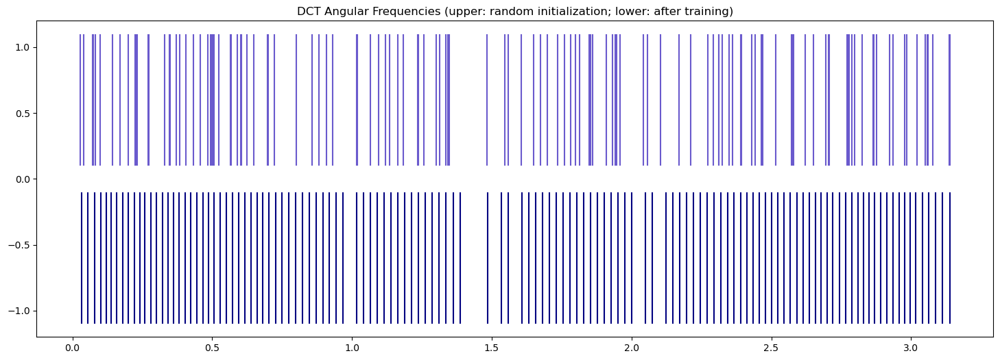

In [63]:
theta_plot = np.zeros((2,M_f))
theta_plot[0,:] = Theta_0
theta_plot[1,:] = DCT_NN.Theta.cpu().detach().numpy()

fig,ax = plt.subplots(figsize=(18, 6))
ax.set_title('DCT Angular Frequencies (upper: random initialization; lower: after training)')
# ax0.set_xlabel("Time (ms)",horizontalalignment='right',position=(1,25))
# ax.set(xlim=(0, np.pi))
ax.set(ylim=(-1.2, 1.2))
ax.eventplot(theta_plot,colors=['slateblue','navy'],lineoffsets = [0.6, -0.6])
plt.show()

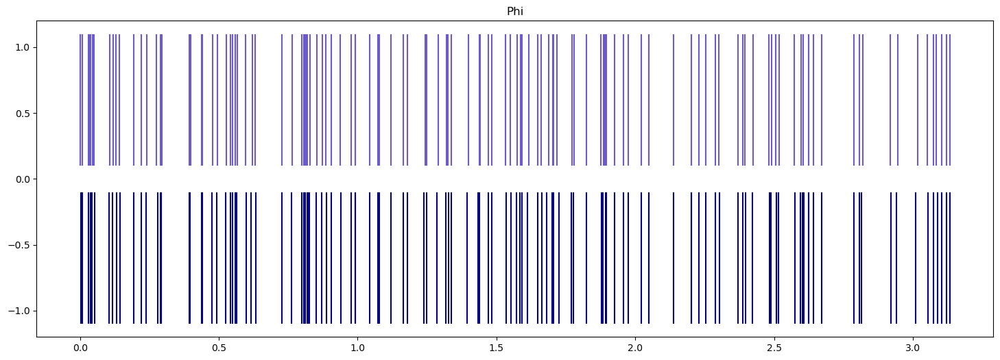

In [47]:
phi_plot = np.zeros((2,M_t))
phi_plot[0,:] = Phi_0
phi_plot[1,:] = DCT_NN.Phi.cpu().detach().numpy()

fig,ax = plt.subplots(figsize=(18, 6))
ax.set_title('Phi')
# ax0.set_xlabel("Time (ms)",horizontalalignment='right',position=(1,25))
# ax.set(xlim=(0, 2*np.pi))
ax.set(ylim=(-1.2, 1.2))
ax.eventplot(phi_plot,colors=['slateblue','navy'],lineoffsets = [0.6, -0.6])
plt.show()

#### Conclusion
- DCT neural networks outperform FC (fully connected) neural networks.
- DCT neural network captures audio data structure and saves parameters dramatically: $O(n^2) \to O(n)$.
- Inserting FC hidden layers results in poor model performance.
- By inventing cosine transform hidden layers (see below), we made the deep neural network train with fast convergence.

### Cosine Transform Hidden Layers

<img src="graphs/DCT_deep.jpg" style="width:800px">
<caption><center> Figure 4. Deep Discrete Cosine Transform Neural Network </center></caption>

1. Input Layer: DCT Layer

\begin{equation}
X_{k_0}^{<0>} = \tanh \Big( \frac{1}{\sqrt{N}} \big(\frac{1}{\sqrt{2}}x_0 + \sum_{n=1}^{N-1} x_n \cos [\theta_{k_0}^{<0>} \cdot n] \big) \Big) \qquad \text{for } k_0 = 0,\dots,M_0-1
\end{equation}

2. Hidden layers*: Cosine Transform Layer
\begin{equation}
X_{k_l}^{<l>} = \tanh \Big( \frac{1}{\sqrt{M_{l-1}}} \big(\sum_{k_{l-1}=0}^{M_{l-1}-1} X_{k_{l-1}}^{<l-1>} \cos[\phi_{k_{l-1}}^{<l-1>} \cdot \theta_{k_l}^{<l>}] \big) \Big) \qquad \text{for } k_l = 0,\dots,M_l-1
\end{equation}

3. Output Layer: IDCT Layer

\begin{align}
x_0 &= \tanh \Big(\frac{1}{\sqrt{2M_{L-1}}} \sum_{k_{L-1}=0}^{M_{L-1}-1} X_{k_{L-1}}^{<L-1>} \Big)\\
x_n &= \tanh \Big(\frac{1}{\sqrt{M_{L-1}}} \sum_{k_{L-1}=0}^{M_{L-1}-1} X_{k_{L-1}}^{<L-1>} \cos [\phi_{k_{L-1}}^{<L-1>} \cdot n] \Big)\quad \text{for } n = 1,\dots,N-1
\end{align}

- In general $M_l \le N$ for all $l = 0, \dots,L-1$.
- Generally, there are two sets of feature parameters $\{\mathbf{\theta}^{<l>}\}_{l = 0, \dots,L-1}$, $\{\phi^{<l>}\}_{l = 0, \dots,L-1}$ to learn.
- Replacing $\phi^{<l>}$ with $\theta^{<l>}$ for each $l$ gives `type_nn` "identical" with shared parameters $\{\mathbf{\theta}^{<l>}\}_{l = 0, \dots,L-1}$.

In [3]:
class DCT_nn_cos:
    """
    DCT layer: Theta
    hidden layer*: cosine transform
    IDCT layer: Phi
    """
    def __init__(self, N, M, dev, type_nn):
        """
        N -- input layer length, int number
        M -- hidden layer length. numpy array of size (m,). M.size is the number of hidden layers
        dev -- torch device
        type_nn -- "general" or "identical". In "identical", Theta = Phi
        """
        self.N = N
        self.M = M
        self.num_hidden = M.size
        self.dev = dev
        self.type_nn = type_nn
        
    def parameter_init(self, type_init, scale):
        """
        Arguments:
        type_init -- "orthogonal" or "random"
        Theta -- time to frequency parameter, torch tensor of shape (N,M_f)
        Phi -- frequency to time parameter, torch tensor of shape (M_t,N)
        W -- parameter set for hidden layers, of size num_hidden-1. torch tensor of shape (M_i,M_i+1)
        """
        self.W_theta = {}
        for i in range(self.num_hidden):
            if type_init == "orthogonal":
                self.W_theta[i] = (torch.arange(self.M[i], device = dev)*2+1)/(2*self.M[i])*scale  
            else:
                self.W_theta[i],index = torch.sort(torch.rand(self.M[i], device=self.dev)*scale)
            self.W_theta[i].requires_grad_(True)
            
        if self.type_nn == "general":
            self.W_phi = {}
            for i in range(self.num_hidden):
                if type_init == "orthogonal":
                    self.W_phi[i] = (torch.arange(self.M[i], device = dev)*2+1)/(2*self.M[i])*scale  
                else:
                    self.W_phi[i],index = torch.sort(torch.rand(self.M[i], device=self.dev)*scale)
                self.W_phi[i].requires_grad_(True)
        elif self.type_nn == "identical":
            self.W_phi = self.W_theta
            
    def forward_pass(self,x_in):
        """
        x_in -- input data, torch tensor of shape (N,batch_size)
        """
        DCT = torch.cos(torch.outer(self.W_theta[0], torch.arange(self.N, device=self.dev)))/np.sqrt(self.N)
        DCT[:,0] = DCT[:,0]/np.sqrt(2)
        IDCT = torch.cos(torch.outer(torch.arange(self.N, device=self.dev),self.W_phi[self.num_hidden-1]))/np.sqrt(self.M[self.num_hidden-1])
        IDCT[0,:] = IDCT[0,:]/np.sqrt(2)
        
        # activation tanh()
        X = torch.tanh(torch.matmul(DCT,x_in))
        if self.num_hidden > 1:
            for i in range(self.num_hidden-1):
                W = torch.cos(torch.outer(self.W_theta[i+1], self.W_phi[i])/np.sqrt(self.M[i]))
                X = torch.tanh(torch.matmul(W,X))
        x_out = torch.tanh(torch.matmul(IDCT,X))
        
        loss = ((x_out - x_in)**2).mean()                      
        return loss
                              
    def param_update(self,loss,lr=0.1):
        loss.backward()
        with torch.no_grad():
            for i in range(self.num_hidden):
                self.W_theta[i] -= lr * self.W_theta[i].grad
                self.W_theta[i].grad.zero_()
            if self.type_nn == "general":
                for i in range(self.num_hidden):
                    self.W_phi[i] -= lr * self.W_phi[i].grad
                    self.W_phi[i].grad.zero_()

In [28]:
N = 512
M = np.array([128,64,256])
DCT_NN = DCT_nn_cos(N,M,dev,type_nn="general")
DCT_NN.parameter_init(type_init="random",scale = torch.pi/2)
W_theta_0 = {}
W_phi_0 = {}
for i in range(M.size):
    W_theta_0[i] = DCT_NN.W_theta[i].cpu().detach().numpy().copy()
    W_phi_0[i] = DCT_NN.W_phi[i].cpu().detach().numpy().copy()

In [66]:
data = torch.rand(N,100000, device=dev)*2-1
num_cut = data.shape[1]
data

tensor([[ 0.6311, -0.7779, -0.6189,  ..., -0.8642, -0.8654,  0.3575],
        [ 0.4612, -0.8830, -0.8366,  ..., -0.7174, -0.6055, -0.6041],
        [-0.7424,  0.4786,  0.3732,  ...,  0.0695,  0.7419,  0.9144],
        ...,
        [-0.2903,  0.1493,  0.4070,  ...,  0.7861, -0.4034, -0.9883],
        [ 0.7005,  0.2050, -0.5497,  ...,  0.0651, -0.9850,  0.8617],
        [-0.8383, -0.2944,  0.7906,  ..., -0.7364,  0.4545,  0.1680]],
       device='cuda:0')

In [8]:
a0 = 0.53836
window = a0 - (1-a0)*torch.cos(torch.arange(N,device=dev)*2*torch.pi/N).reshape(-1,1)
num_cut = int(y_audio.size/N)
y_audio = y_audio[:N*num_cut]
data = torch.tensor(y_audio.reshape(N,num_cut),device=dev) * window
data

tensor([[-5.8819e-07,  6.5078e-07, -4.4100e-07,  ...,  2.7364e-03,
          2.7551e-03,  2.5124e-03],
        [ 2.2885e-03,  2.4416e-03,  2.2740e-03,  ...,  1.7569e-03,
          3.4616e-03,  5.6427e-03],
        [ 5.6232e-03,  5.8623e-03,  7.2461e-03,  ...,  1.6423e-03,
          5.6863e-04, -6.1067e-04],
        ...,
        [ 2.3218e-03,  2.5483e-03,  2.6088e-03,  ..., -6.7751e-03,
         -6.4859e-03, -5.9407e-03],
        [-5.2867e-03, -4.6546e-03, -3.9352e-03,  ..., -1.8711e-03,
         -2.1099e-03, -2.1986e-03],
        [-2.1656e-03, -2.1180e-03, -2.0355e-03,  ...,  1.5537e-03,
          1.5247e-03,  1.5017e-03]], device='cuda:0')

In [29]:
pre_Loss = DCT_NN.forward_pass(data)
pre_Loss.backward()
lr = 0.06
pre_Loss

tensor(0.3162, device='cuda:0', grad_fn=<MeanBackward0>)

In [26]:
epoch = 100

In [172]:
for e in range(epoch):  
    loss = DCT_NN.forward_pass(data)
    DCT_NN.param_update(loss,lr=lr)
    Loss = loss.item()
    if Loss > pre_Loss:
        lr /= 2
        print('learning rate:', lr)
    pre_Loss = Loss
    print(f"Loss: {Loss:>4f}")

Loss: 0.272853
learning rate: 0.03
Loss: 0.291940
Loss: 0.272046
Loss: 0.244313
learning rate: 0.015
Loss: 0.275106
learning rate: 0.0075
Loss: 0.293938
Loss: 0.270976
Loss: 0.224546
Loss: 0.199260
Loss: 0.181934
Loss: 0.160037
learning rate: 0.00375
Loss: 0.163882
learning rate: 0.001875
Loss: 0.168173
Loss: 0.110575
Loss: 0.074254
Loss: 0.063111
Loss: 0.058833
Loss: 0.055790
learning rate: 0.0009375
Loss: 0.056122
Loss: 0.054336
Loss: 0.040726
Loss: 0.039468
Loss: 0.038524
Loss: 0.037688
Loss: 0.036931
Loss: 0.036253
Loss: 0.035606
Loss: 0.035013
Loss: 0.034450
Loss: 0.033918
Loss: 0.033405
Loss: 0.032950
Loss: 0.032555
Loss: 0.032204
Loss: 0.031910
Loss: 0.031634
Loss: 0.031399
Loss: 0.031181
Loss: 0.030970
Loss: 0.030785
Loss: 0.030604
Loss: 0.030437
Loss: 0.030276
Loss: 0.030132
Loss: 0.029997
Loss: 0.029865
Loss: 0.029735
Loss: 0.029620
Loss: 0.029495
Loss: 0.029381
Loss: 0.029271
Loss: 0.029179
Loss: 0.029064
Loss: 0.028967
Loss: 0.028861
Loss: 0.028769
Loss: 0.028669
Loss: 0.02

0.12
0.065308 /2 0.025457
0.031613 /3
0.039569 /4
0.040162 /5

In [173]:
W_theta = {}
W_phi = {}
for i in range(M.size):
    W_theta[i] = DCT_NN.W_theta[i].cpu().detach().numpy().copy()
    W_phi[i] = DCT_NN.W_phi[i].cpu().detach().numpy().copy()

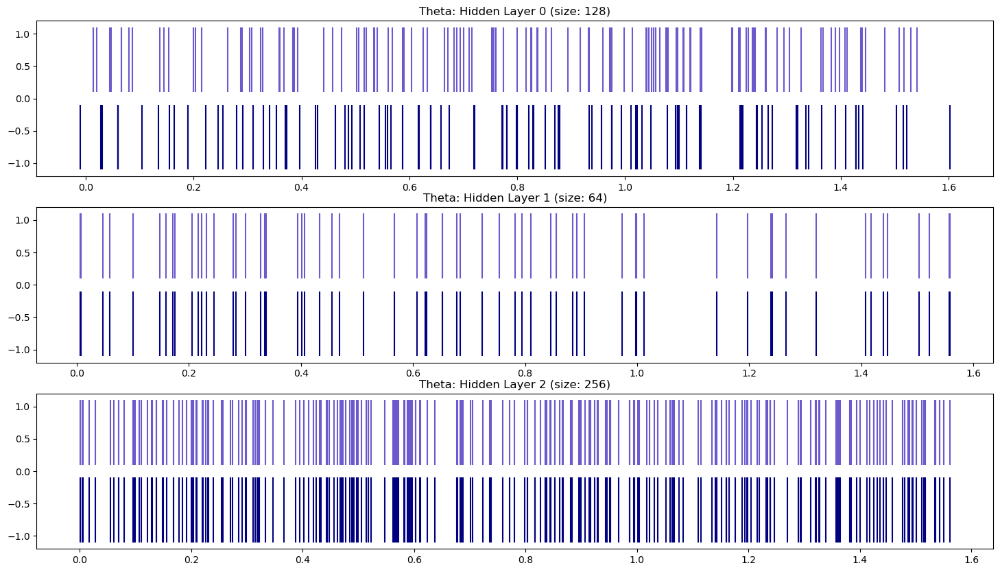

In [175]:
if M.size == 1:
    theta_plot = np.zeros((2,M[0]))
    theta_plot[0,:] = W_theta_0[0]
    theta_plot[1,:] = DCT_NN.W_theta[0].cpu().detach().numpy()

    fig,ax = plt.subplots(figsize=(18, 6))
    ax.set_title('Theta')
    # ax0.set_xlabel("Time (ms)",horizontalalignment='right',position=(1,25))
    # ax.set(xlim=(0, np.pi))
    ax.set(ylim=(-1.2, 1.2))
    ax.eventplot(theta_plot,colors=['slateblue','navy'],lineoffsets = [0.6, -0.6])
else:
    fig,ax = plt.subplots(M.size,1,figsize=(18, 10))
    # fig.suptitle("Theta Plot")
    for i in range(M.size):
        theta_plot = np.zeros((2,M[i]))
        theta_plot[0,:] = W_theta_0[i]
        theta_plot[1,:] = W_theta[i]
        ax[i].set_title('Theta: Hidden Layer '+str(i) + ' (size: ' + str(M[i]) + ')')
        ax[i].set(ylim=(-1.2, 1.2))
        ax[i].eventplot(theta_plot,colors=['slateblue','navy'],lineoffsets = [0.6, -0.6])
plt.show()

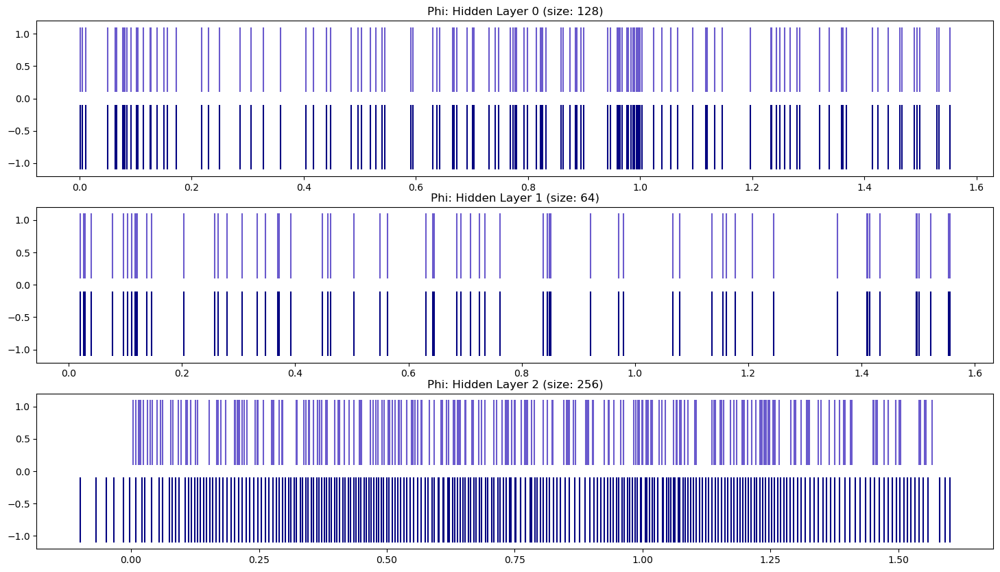

In [174]:
if M.size == 1:
    phi_plot = np.zeros((2,M[0]))
    phi_plot[0,:] = W_phi_0[0]
    phi_plot[1,:] = DCT_NN.W_phi[0].cpu().detach().numpy()

    fig,ax = plt.subplots(figsize=(18, 6))
    ax.set_title('Phi')
    # ax0.set_xlabel("Time (ms)",horizontalalignment='right',position=(1,25))
    # ax.set(xlim=(0, 2*np.pi))
    ax.set(ylim=(-1.2, 1.2))
    ax.eventplot(phi_plot,colors=['slateblue','navy'],lineoffsets = [0.6, -0.6])
else:
    fig,ax = plt.subplots(M.size,1,figsize=(18, 10))
    # fig.suptitle("Phi Plot")
    for i in range(M.size):
        phi_plot = np.zeros((2,M[i]))
        phi_plot[0,:] = W_phi_0[i]
        phi_plot[1,:] = W_phi[i]
        ax[i].set_title('Phi: Hidden Layer '+str(i) + ' (size: ' + str(M[i]) + ')')
        ax[i].set(ylim=(-1.2, 1.2))
        ax[i].eventplot(phi_plot,colors=['slateblue','navy'],lineoffsets = [0.6, -0.6])
plt.show()